In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import json
import numpy as np
import pandas as pd
from unidecode import unidecode
from ipywidgets import interact, interact_manual, widgets, VBox, HBox
import folium
import jenkspy
from jenkspy import jenks_breaks
from folium.plugins import HeatMap
from folium.plugins import GroupedLayerControl

In [2]:
#Variaveis
distrito = 'teal'
ciclovia = 'red'
ciclofaixa = 'aqua'
ciclorrota = 'yellow'
acidente = 'blue'
style_distrito = lambda style:{'color':distrito, 'weight': 2}
style_ciclorrota = lambda style:{'color':ciclorrota, 'weight': 2}
style_ciclovia = lambda style:{'color':ciclovia, 'weight': 2}
style_ciclofaixa = lambda style:{'color':ciclofaixa, 'weight': 2}

In [3]:
def cria_e_adiciona_features(nome,mapa,mostra):
    feature = folium.FeatureGroup(name= nome,show=mostra)
    feature.add_to(mapa)
    return feature

def tratar_coordenadas(dataframe):
    for i in dataframe.index:
        dataframe.loc[i, 'LAT_(GEO)'] = dataframe.loc[i, 'LAT_(GEO)'].replace(',','.')
        dataframe.loc[i, 'LONG_(GEO)'] = dataframe.loc[i, 'LONG_(GEO)'].replace(',','.')

def adicionar_camadas(camada,mapa,cor):
    if cor == 'distrito':
        folium.GeoJson(camada, style_function=style_distrito, name='Distritos',zoom_on_click=True).add_to(mapa)
    elif cor == 'ciclorrota':
        folium.GeoJson(camada, style_function=style_ciclorrota, name='Ciclorrota').add_to(mapa)
    elif cor == 'ciclovia':
        folium.GeoJson(camada, style_function=style_ciclovia, name='Ciclovia').add_to(mapa)    
    else:
        folium.GeoJson(camada, style_function=style_ciclofaixa, name='Ciclofaixa').add_to(mapa)

# Panorama geral da infraestrutura cicloviária na cidade de São Paulo

## Importação dos Dados Geoespaciais - Infraestrutura Cicloviária e Distritos

In [4]:
# Ciclovia e Ciclofaixa
gdf_infra_cicloviaria = gpd.read_file("../dados/SP/shapesInfraestruturaCicloviaria/Ciclovias.shp")

# Separando Ciclovias de ciclofaixas
gdf_ciclofaixa = gdf_infra_cicloviaria[gdf_infra_cicloviaria['programa'] < 'CICLOVIA']

gdf_ciclovia = pd.merge(gdf_infra_cicloviaria,gdf_ciclofaixa, indicator=True, how='outer').query('_merge=="left_only"').drop('_merge', axis=1)

# Ciclorrota
gdf_ciclorrota = gpd.read_file("../dados/SP/shapesInfraestruturaCicloviaria/Ciclorrotas.shp")
gdf_ciclorrota = gdf_ciclorrota.set_crs(epsg='4326')

# Distrito
gdf_distrito = gpd.read_file("../dados/SP/LAYER_DISTRITO/DEINFO_DISTRITO.shp")

## Distribuição das infraestruturas

In [5]:
# Mapa de SP
# Latitude 23.5401 sul e longitude 46.6402 oeste
infra_cicloviaria = folium.Map(location=[-23.5401,-46.6402], zoom_start=11)

base_map = folium.FeatureGroup(name='Basemap', overlay=True, control=False)
folium.TileLayer(tiles='cartodbpositron').add_to(base_map)
base_map.add_to(infra_cicloviaria)

layer1 = cria_e_adiciona_features('Distrito',infra_cicloviaria,True)
layer2 = cria_e_adiciona_features('Ciclovia',infra_cicloviaria,True)
layer3 = cria_e_adiciona_features('Ciclorrota',infra_cicloviaria,True)
layer4 = cria_e_adiciona_features('Ciclofaixa',infra_cicloviaria,True)

#Setando CRS pro shp das ciclovias:
gdf_ciclovia = gdf_ciclovia.set_crs(epsg=4326)
gdf_ciclofaixa = gdf_ciclofaixa.set_crs(epsg=4326)
gdf_distrito = gdf_distrito.to_crs(epsg='4326')

#Adiconando camadas de Distritos de SP e Ciclovias
adicionar_camadas(gdf_distrito,layer1,'distrito')
adicionar_camadas(gdf_ciclovia,layer2,'ciclovia')
adicionar_camadas(gdf_ciclorrota,layer3,'ciclorrota')
adicionar_camadas(gdf_ciclofaixa,layer4,'ciclofaixa')

folium.LayerControl(collapsed=False).add_to(infra_cicloviaria)
infra_cicloviaria

In [6]:
infra_cicloviaria.save("infra_cicloviaria.html")

## Cobertura cicloviária por distrito

In [7]:
extensao_ciclovias = gdf_ciclovia.drop(['inauguracao','extensao_c'], axis= 'columns')
extensao_ciclofaixas = gdf_ciclofaixa.drop(['inauguracao','extensao_c'], axis= 'columns')
extensao_ciclorrota = gdf_ciclorrota.drop(['inauguracao','extensao_c'], axis= 'columns')

union_extensoes_ciclo = pd.concat([extensao_ciclovias,extensao_ciclofaixas,extensao_ciclorrota])

area_distritos = gdf_distrito[['NOME_DIST','COD_DIST','geometry']]
area_distritos = area_distritos.to_crs(epsg=6933)
area_distritos['AREA(m2)'] = area_distritos.area.values
area_distritos = area_distritos.to_crs(epsg=4326)

ciclovia_join_distrito = gpd.sjoin(left_df= area_distritos, right_df=union_extensoes_ciclo, how='left')

df_area_distrito_extensao_ciclo = ciclovia_join_distrito.groupby(['NOME_DIST','AREA(m2)'], as_index=False)['extensao_t'].sum()

df_area_distrito_extensao_ciclo['Cobertura Cicloviária (m/km²)'] = df_area_distrito_extensao_ciclo['extensao_t'] / (df_area_distrito_extensao_ciclo['AREA(m2)'] / 1000000)

In [8]:
mapa_cobertura_cicloviaria = folium.Map(location=[-23.7201,-46.6402],
                                  attr= 'Heatmap',
                                  zoom_start=10)
    
choropleth_cobertura_cicloviaria = folium.Choropleth(
    geo_data=gdf_distrito,
    data=df_area_distrito_extensao_ciclo,
    columns=['NOME_DIST','Cobertura Cicloviária (m/km²)'],
    key_on='feature.properties.NOME_DIST',
    bins=10,
    use_jenks=True,
    fill_color='BuGn', #'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'
    fill_opacity=1,
    line_opacity=0.2,
    smooth_factor=0,
    Highlight= False,
    line_color = "Black",
    nan_fill_color = "White",
    legend_name= 'Valor'
).add_to(mapa_cobertura_cicloviaria)

dados_cobertura_cicloviaria_indexed = df_area_distrito_extensao_ciclo.set_index('NOME_DIST')

for row in choropleth_cobertura_cicloviaria.geojson.data['features']:
    try:
        row['properties']['Cobertura Cicloviária (m/km²)'] = str(dados_cobertura_cicloviaria_indexed.loc[row['properties']['NOME_DIST'],'Cobertura Cicloviária (m/km²)'])
    except KeyError:
        row['properties']['Cobertura Cicloviária (m/km²)'] = 'No adherents'

folium.GeoJsonTooltip(['NOME_DIST', 'Cobertura Cicloviária (m/km²)']).add_to(choropleth_cobertura_cicloviaria.geojson)

mapa_cobertura_cicloviaria

# Panorama dos acidentes: total e pra cada 1000 habitantes do distrito

## Importação dos Dados de Acidentes e População

In [9]:
# Acidentes Não Fatais
nao_fatais = pd.read_csv("../dados/SP/acidentes_naofatais.csv", delimiter=";", encoding='unicode_escape')

# Óbitos
obitos_sp = pd.read_csv('../dados/SP/obitos_publico.csv', delimiter=';', encoding='unicode_escape')

# População
df_populacional = pd.read_csv("../dados/SP/evolucao_msp_crescimento2000_50.csv", delimiter=";", encoding='unicode_escape')

## Limpeza dos dados de acidentes

In [10]:
sp_nao_fatais = nao_fatais[nao_fatais['Município'] == "SAO PAULO"]

In [11]:
coord_acidentes_nao_fatais = sp_nao_fatais.drop(['Relevo', 'Superfície da via', 'Tipo de pavimento', 'Obras na pista',
                                                 'Tipo de Acidente - Atropelamento (Animal)', 'Data do Acidente',
                                                 'Batalhão de Trânsito', 'Companhia de Trânsito',
                                                 'Serviço de Atendimento - Bombeiro', 'Serviço de Atendimento - PMRV',
                                                 'Serviço de Atendimento - PRF', 'Serviço de Atendimento - Radio Patrulha',
                                                 'Servciço de Atendimento - CPTRAN'], axis=1)

In [12]:
len(coord_acidentes_nao_fatais)

179245

In [13]:
coord_acidentes_nao_fatais.isnull().sum()

ID                                                 0
Dia do Acidente                                    0
Mês do Acidente                                    0
Ano do Acidente                                    0
Ano/Mês do Acidente                                0
Dia da Semana                                      0
Hora do Acidente                                   0
Turno                                              0
Município                                          0
Região Administrativa                              0
Logradouro                                         0
Numero/KM                                          0
Jurisdição                                         0
Administração                                      0
Conservação                                        0
LAT_(GEO)                                      13001
LONG_(GEO)                                     13018
Condições Climáticas                               0
Iluminação                                    

In [14]:
coord_acidentes_nao_fatais = coord_acidentes_nao_fatais.dropna()

In [15]:
acid_ciclistas = coord_acidentes_nao_fatais[coord_acidentes_nao_fatais['Veículos Envolvidos - Bicicleta'] == 1]
acid_pedestres = coord_acidentes_nao_fatais[coord_acidentes_nao_fatais['Veículos Envolvidos - Pedestre'] == 1]

In [16]:
acid_ciclistas[((acid_ciclistas['Mês do Acidente'] == 'JANEIRO') | (acid_ciclistas['Mês do Acidente'] == 'FEVEREIRO')) & (acid_ciclistas['Ano do Acidente'] == 2023)]

,ID,Dia do Acidente,Mês do Acidente,Ano do Acidente,Ano/Mês do Acidente,Dia da Semana,Hora do Acidente,Turno,Município,Região Administrativa,...,Veículos Envolvidos - Pedestre,Pessoas Envolvidas - Grave,Pessoas Envolvidas - Ileso,Pessoas Envolvidas - Leve,Tipo de Via,Tipo de Acidente - Atropelamento (Pedestre),Tipo de Acidente - Choque,Tipo de Acidente - Colisão,Tipo de Acidente - Outros tipos de Acidente,Turno + Dia de Semana
31238,8951910,28,FEVEREIRO,2023,2023.02,TERÇA,02:08,MADRUGADA,SAO PAULO,Metropolitana de São Paulo,...,0,0,0,1,Vias Municipais,0,1,0,0,MADRUGADA DE TERÇA
31289,8956241,28,FEVEREIRO,2023,2023.02,TERÇA,19:33,NOITE,SAO PAULO,Metropolitana de São Paulo,...,0,0,0,0,Vias Municipais,0,0,1,0,NOITE DE TERÇA
31343,8953428,28,FEVEREIRO,2023,2023.02,TERÇA,20:43,NOITE,SAO PAULO,Metropolitana de São Paulo,...,0,0,0,1,Vias Municipais,0,0,1,0,NOITE DE TERÇA
31381,8952214,28,FEVEREIRO,2023,2023.02,TERÇA,09:41,MANHA,SAO PAULO,Metropolitana de São Paulo,...,1,0,1,1,Vias Municipais,0,0,1,0,MANHA DE TERÇA
31394,8951904,28,FEVEREIRO,2023,2023.02,TERÇA,00:51,MADRUGADA,SAO PAULO,Metropolitana de São Paulo,...,0,0,1,1,Vias Municipais,0,0,0,0,MADRUGADA DE TERÇA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56522,8783369,3,JANEIRO,2023,2023.01,TERÇA,21:44,NOITE,SAO PAULO,Metropolitana de São Paulo,...,0,0,1,1,Vias Municipais,0,1,0,0,NOITE DE TERÇA
56524,8782726,3,JANEIRO,2023,2023.01,TERÇA,14:02,TARDE,SAO PAULO,Metropolitana de São Paulo,...,0,0,0,2,Vias Municipais,0,0,0,1,TARDE DE TERÇA
56529,8782941,3,JANEIRO,2023,2023.01,TERÇA,16:02,TARDE,SAO PAULO,Metropolitana de São Paulo,...,0,0,1,1,Vias Municipais,0,0,0,0,TARDE DE TERÇA
56899,8781925,2,JANEIRO,2023,2023.01,SEGUNDA,20:04,NOITE,SAO PAULO,Metropolitana de São Paulo,...,0,0,2,1,Vias Municipais,0,0,0,0,NOITE DE SEGUNDA


In [17]:
tratar_coordenadas(acid_ciclistas)
tratar_coordenadas(acid_pedestres)

In [18]:
nao_fatais[['LAT_(GEO)','LONG_(GEO)']]

,LAT_(GEO),LONG_(GEO)
0,"-23,9504576863529","-46,3998176537352"
1,"-21,6482190999999","-51,0884237"
2,"-23,4182190509999","-46,4348680739999"
3,"-23,977787204","-48,8750450209999"
4,NaN,NaN
...,...,...
770179,"-22,7623403","-45,2169583"
770180,"-22,4007034341","-47,580049086"
770181,"-23,2177706","-47,5212399"
770182,NaN,NaN


In [19]:
acid_ciclistas, acid_pedestres = acid_ciclistas.rename(columns={"LAT_(GEO)": "Latitude", "LONG_(GEO)": "Longitude"}), acid_pedestres.rename(columns={"LAT_(GEO)": "Latitude", "LONG_(GEO)": "Longitude"})

In [20]:
gdf_acidentes_ciclistas_localizados = gpd.GeoDataFrame(
    acid_ciclistas, geometry=gpd.points_from_xy(acid_ciclistas.Longitude, acid_ciclistas.Latitude), crs="EPSG:4326"
)

gdf_acidentes_pedestres_localizados = gpd.GeoDataFrame(
    acid_pedestres, geometry=gpd.points_from_xy(acid_pedestres.Longitude, acid_pedestres.Latitude), crs="EPSG:4326"
)

In [21]:
acidentes_ciclistas_distrito = gpd.sjoin(left_df= gdf_distrito, right_df=gdf_acidentes_ciclistas_localizados, how='left')
acidentes_pedestres_distrito = gpd.sjoin(left_df= gdf_distrito, right_df=gdf_acidentes_pedestres_localizados, how='left')

In [22]:
total_acidentes_ciclistas = acidentes_ciclistas_distrito.groupby('NOME_DIST', as_index=False)['ID'].count()
total_acidentes_pedestres = acidentes_pedestres_distrito.groupby('NOME_DIST', as_index=False)['ID'].count()

In [23]:
total_acidentes_ciclistas = total_acidentes_ciclistas.rename(columns={"NOME_DIST": "Distrito", "ID": "Qtd_Acidente"})
total_acidentes_pedestres = total_acidentes_pedestres.rename(columns={"NOME_DIST": "Distrito", "ID": "Qtd_Acidente"})

In [24]:
total_acidentes_pedestres.head()

,Distrito,Qtd_Acidente
0,AGUA RASA,115
1,ALTO DE PINHEIROS,42
2,ANHANGUERA,61
3,ARICANDUVA,105
4,ARTUR ALVIM,121


## Limpeza dos dados de óbitos

In [25]:
obitos_ciclista_em_sp = obitos_sp[(obitos_sp['Tipo do veículo da vítima'] == 'BICICLETA') & (obitos_sp['Município'] == 'SAO PAULO')]
obitos_pedestres_em_sp = obitos_sp[(obitos_sp['Tipo do veículo da vítima'] == 'PEDESTRE') & (obitos_sp['Município'] == 'SAO PAULO')]

In [26]:
coord_obitos_ciclista_em_sp = obitos_ciclista_em_sp.drop(['Tipo de via','Administração', 'Jurisdição',
                                                          'Conservação', 'Região Administrativa', 'Logradouro',
                                                          'Númeral / KM', 'Tipo do local da ocorrência',
                                                          'Sub Tipo do Acidente'], axis=1)

coord_obitos_pedestres_em_sp = obitos_pedestres_em_sp.drop(['Tipo de via','Administração', 'Jurisdição',
                                                            'Conservação', 'Região Administrativa', 'Logradouro',
                                                            'Númeral / KM', 'Tipo do local da ocorrência',
                                                            'Sub Tipo do Acidente'], axis=1)

In [27]:
tratar_coordenadas(coord_obitos_ciclista_em_sp)
tratar_coordenadas(coord_obitos_pedestres_em_sp)

In [28]:
coord_obitos_ciclista_em_sp = coord_obitos_ciclista_em_sp.rename(columns={"LAT_(GEO)": "Latitude", "LONG_(GEO)": "Longitude"})
coord_obitos_pedestres_em_sp = coord_obitos_pedestres_em_sp.rename(columns={"LAT_(GEO)": "Latitude", "LONG_(GEO)": "Longitude"})

In [29]:
coord_obitos_pedestres_em_sp = coord_obitos_pedestres_em_sp[coord_obitos_pedestres_em_sp.Longitude != 'NAO DISPONIVEL']
coord_obitos_ciclista_em_sp = coord_obitos_ciclista_em_sp[coord_obitos_ciclista_em_sp.Longitude != 'NAO DISPONIVEL']

In [30]:
gdf_obitos_ciclistas_localizados = gpd.GeoDataFrame(
    coord_obitos_ciclista_em_sp, geometry=gpd.points_from_xy(coord_obitos_ciclista_em_sp.Longitude, coord_obitos_ciclista_em_sp.Latitude), crs="EPSG:4326"
)

gdf_obitos_pedestres_localizados = gpd.GeoDataFrame(
    coord_obitos_pedestres_em_sp, geometry=gpd.points_from_xy(coord_obitos_pedestres_em_sp.Longitude, coord_obitos_pedestres_em_sp.Latitude), crs="EPSG:4326"
)

In [31]:
obitos_ciclistas_distrito = gpd.sjoin(left_df= gdf_distrito, right_df=gdf_obitos_ciclistas_localizados, how='left')
obitos_pedestres_distrito = gpd.sjoin(left_df= gdf_distrito, right_df=gdf_obitos_pedestres_localizados, how='left')

In [32]:
total_obitos_ciclistas = obitos_ciclistas_distrito.groupby('NOME_DIST', as_index=False)['Número do Bo (RDO)'].count()
total_obitos_pedestres = obitos_pedestres_distrito.groupby('NOME_DIST', as_index=False)['Número do Bo (RDO)'].count()

total_obitos_ciclistas = total_obitos_ciclistas.rename(columns={"NOME_DIST": "Distrito", "Número do Bo (RDO)": "Qtd_Acidente"})
total_obitos_pedestres = total_obitos_pedestres.rename(columns={"NOME_DIST": "Distrito", "Número do Bo (RDO)": "Qtd_Acidente"})

In [33]:
total_obitos_ciclistas.head()

,Distrito,Qtd_Acidente
0,AGUA RASA,2
1,ALTO DE PINHEIROS,1
2,ANHANGUERA,3
3,ARICANDUVA,0
4,ARTUR ALVIM,0


## Limpeza dos dados populacionais

In [34]:
def corrigir_nomes(nome):
    nome = unidecode(nome.upper())
    return nome

df_populacional['distrito'] = df_populacional['distrito'].apply(corrigir_nomes)

pop_acidentes_ciclistas = total_acidentes_ciclistas.rename(columns={"NOME_DIST": "Distrito", "Qtd_Acidente": "Acidente Ciclistas"})
pop_acidentes_pedestres = total_acidentes_pedestres.rename(columns={"NOME_DIST": "Distrito", "Qtd_Acidente": "Acidente Pedestres"})

In [35]:
df_populacional = df_populacional[['distrito','populacao_2020']]
df_populacional.head()

,distrito,populacao_2020
0,AGUA RASA,82.564
1,ALTO DE PINHEIROS,40.962
2,ANHANGUERA,84.719
3,ARICANDUVA,85.868
4,ARTUR ALVIM,100.462


In [36]:
for i in df_populacional.index:
    df_populacional.loc[i, 'distrito'] = df_populacional.loc[i, 'distrito'].replace('JARDIM','JD')
    df_populacional.loc[i, 'distrito'] = df_populacional.loc[i, 'distrito'].replace('CIDADE','CID')

## Junção dos dados de Acidentes com os dados Populacionais por Distrito

In [37]:
# Juntando dados de acidentes, óbitos e populacional
acidentes_populacao = pd.merge(df_populacional,pop_acidentes_ciclistas, left_on='distrito', right_on='Distrito')
acidentes_populacao = pd.merge(acidentes_populacao,pop_acidentes_pedestres, left_on='distrito', right_on='Distrito')
acidentes_populacao = pd.merge(acidentes_populacao,total_obitos_ciclistas, left_on='distrito', right_on='Distrito')
acidentes_populacao = pd.merge(acidentes_populacao,total_obitos_pedestres, left_on='distrito', right_on='Distrito')

# Limpando e tratando o novo dataframe unificado
acidentes_populacao = acidentes_populacao.drop(['distrito','Distrito_y'],axis=1)

acidentes_populacao['Acidente Ciclistas'] = acidentes_populacao['Acidente Ciclistas'] + acidentes_populacao['Qtd_Acidente_x']
acidentes_populacao['Acidente Pedestres'] = acidentes_populacao['Acidente Pedestres'] + acidentes_populacao['Qtd_Acidente_y']

acidentes_populacao = acidentes_populacao.drop(['Qtd_Acidente_x','Qtd_Acidente_y'], axis=1)

acidentes_populacao = acidentes_populacao.iloc[: , :-1]

acidentes_populacao['populacao_2020'] = acidentes_populacao['populacao_2020'] * 1000

# Criação de métricas para análise
acidentes_populacao['Ciclistas/1000 Habitantes'] = acidentes_populacao['Acidente Ciclistas'] * 1000 / acidentes_populacao['populacao_2020']
acidentes_populacao['Pedestres/1000 Habitantes'] = acidentes_populacao['Acidente Pedestres'] * 1000 / acidentes_populacao['populacao_2020']
acidentes_populacao = acidentes_populacao.rename(columns={"Distrito_x": "Distrito","populacao_2020": "População"})

# Gerando o dataset de opção para criação da visualização
dados_panorama_acidentes = acidentes_populacao.rename(columns={"populacao_2020": "População"}).drop('Distrito',axis=1)

C:\Users\danil\AppData\Local\Temp\ipykernel_29052\2967920392.py:5: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Distrito_x'} in the result is deprecated and will raise a MergeError in a future version.
  acidentes_populacao = pd.merge(acidentes_populacao,total_obitos_pedestres, left_on='distrito', right_on='Distrito')


## Visualização

In [38]:
opcoes = dados_panorama_acidentes

def gera_mapa(opcao):
    
    mapa_sp = folium.Map(location=[-23.7201,-46.6402],
                                  attr= 'Heatmap',
                                  zoom_start=10)
    
    choropleth_map = folium.Choropleth(
        geo_data=gdf_distrito,
        data=acidentes_populacao,
        columns=['Distrito',opcao],
        key_on='feature.properties.NOME_DIST',
        bins=10,
        use_jenks=True,
        fill_color='YlOrRd', #'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'
        fill_opacity=1,
        line_opacity=0.2,
        smooth_factor=0,
        Highlight= False,
        line_color = "Black",
        nan_fill_color = "White",
        legend_name= 'Valor'
    ).add_to(mapa_sp)
    
    dados_acidentes_heatmap_indexed = acidentes_populacao.set_index('Distrito')

    for row in choropleth_map.geojson.data['features']:
        try:
            row['properties'][opcao] = str(dados_acidentes_heatmap_indexed.loc[row['properties']['NOME_DIST'],opcao])
        except KeyError:
            row['properties'][opcao] = 'No adherents'

    folium.GeoJsonTooltip(['NOME_DIST', opcao]).add_to(choropleth_map.geojson)
    
    display(mapa_sp)

opcao_widget = widgets.ToggleButtons(options=opcoes, layout={'width': 'max-content'}, description='Análise:')
interact(gera_mapa, opcao=opcao_widget)

interactive(children=(ToggleButtons(description='Análise:', layout=Layout(width='max-content'), options=('Popu…

<function __main__.gera_mapa(opcao)>

In [39]:
dados_panorama_acidentes.corr()

,População,Acidente Ciclistas,Acidente Pedestres,Ciclistas/1000 Habitantes,Pedestres/1000 Habitantes
População,1.000000,0.236055,0.679739,-0.547671,-0.428688
Acidente Ciclistas,0.236055,1.000000,0.586170,0.450272,0.148906
Acidente Pedestres,0.679739,0.586170,1.000000,0.036035,0.204835
Ciclistas/1000 Habitantes,-0.547671,0.450272,0.036035,1.000000,0.804632
Pedestres/1000 Habitantes,-0.428688,0.148906,0.204835,0.804632,1.000000


# Características dos Acidentes

In [40]:
obitos_ciclista_sp = obitos_sp[(obitos_sp['Tipo do veículo da vítima'] == 'BICICLETA') & (obitos_sp['Ano do BO (RDO)'] > 2018) & (obitos_sp['Município'] == 'SAO PAULO')]
datas_obitos_ciclistas_sp = obitos_ciclista_sp[['Data do Acidente','Hora do Acidente']]
datas_obitos_ciclistas_sp['Data do Acidente'] = datas_obitos_ciclistas_sp['Data do Acidente'].str.slice(5, 7)
datas_obitos_ciclistas_sp['Hora do Acidente'] = datas_obitos_ciclistas_sp['Hora do Acidente'].str.slice(0, 2)

nao_fatais_ciclistas = nao_fatais[(nao_fatais['Veículos Envolvidos - Bicicleta'] == 1) & (nao_fatais['Município'] == "SAO PAULO")]
datas_nao_fatais_ciclistas = nao_fatais_ciclistas[['Data do Acidente','Hora do Acidente']]
datas_nao_fatais_ciclistas['Data do Acidente'] = datas_nao_fatais_ciclistas['Data do Acidente'].str.slice(5, 7)
datas_nao_fatais_ciclistas['Hora do Acidente'] = datas_nao_fatais_ciclistas['Hora do Acidente'].str.slice(0, 2)

data_acidentes = pd.concat([datas_obitos_ciclistas_sp,datas_nao_fatais_ciclistas],axis=0)
data_acidentes = data_acidentes.sort_values(by= ['Data do Acidente','Hora do Acidente'],ascending=True)
data_acidentes = data_acidentes.rename(columns={"Data do Acidente": "Mês do Acidente"})

C:\Users\danil\AppData\Local\Temp\ipykernel_29052\887056293.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datas_obitos_ciclistas_sp['Data do Acidente'] = datas_obitos_ciclistas_sp['Data do Acidente'].str.slice(5, 7)
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\887056293.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datas_obitos_ciclistas_sp['Hora do Acidente'] = datas_obitos_ciclistas_sp['Hora do Acidente'].str.slice(0, 2)
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\887056293.py:8: Se

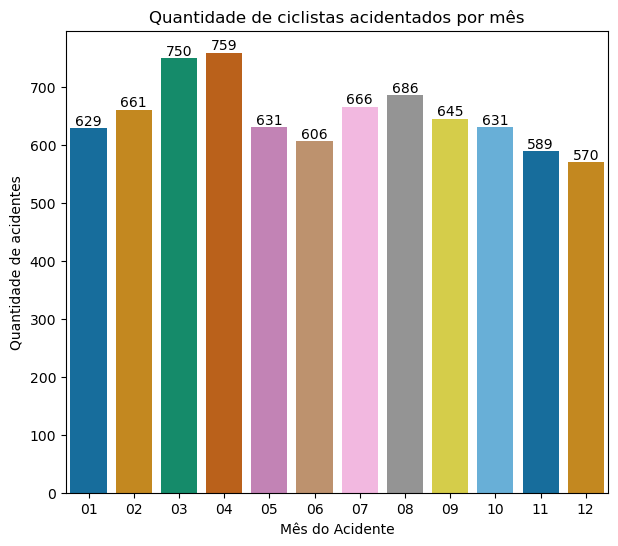

In [41]:
fig, ax = plt.subplots(figsize=(7, 6))
sns.countplot(data=data_acidentes,x='Mês do Acidente', palette="colorblind" ,ax= ax)
for bars in ax.containers:
    ax.bar_label(bars)
    
plt.title('Quantidade de ciclistas acidentados por mês')
plt.ylabel('Quantidade de acidentes')

plt.savefig('acidentes_mes.png', dpi=fig.dpi)

plt.show()

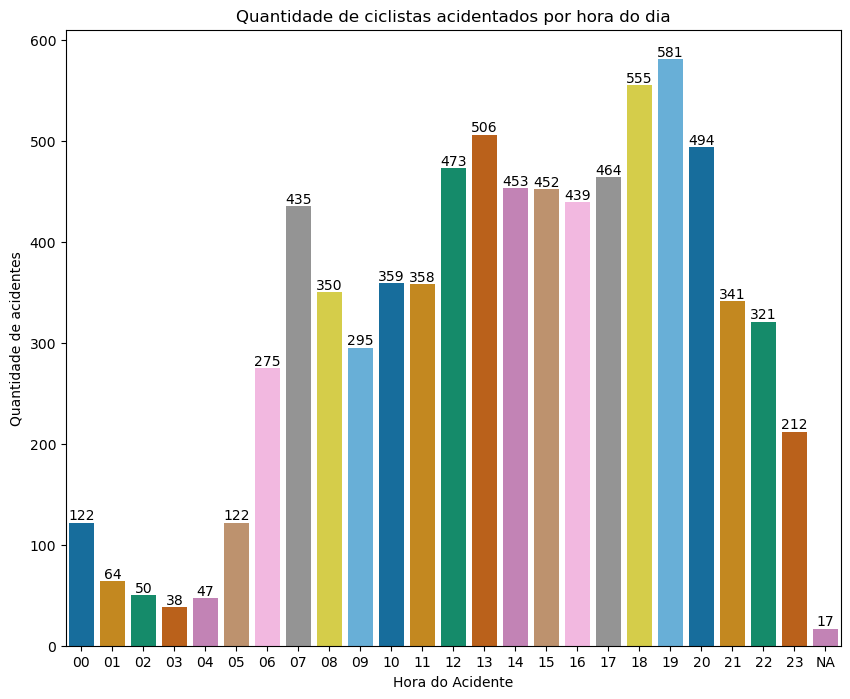

In [42]:
fig, ax = plt.subplots(figsize=(10, 8))
sns.countplot(data=data_acidentes,x='Hora do Acidente', palette="colorblind", ax= ax)
for bars in ax.containers:
    ax.bar_label(bars)

plt.title('Quantidade de ciclistas acidentados por hora do dia')
plt.ylabel('Quantidade de acidentes')

plt.savefig('acidentes_hora_do_dia.png', dpi=fig.dpi)


plt.show()

C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1916238080.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  obitos_ciclista_sp_faixa_etaria['Faixa etária'] = obitos_ciclista_sp_faixa_etaria['Faixa etária'].replace({'NAO DISPONIVEL': 'N/A'})


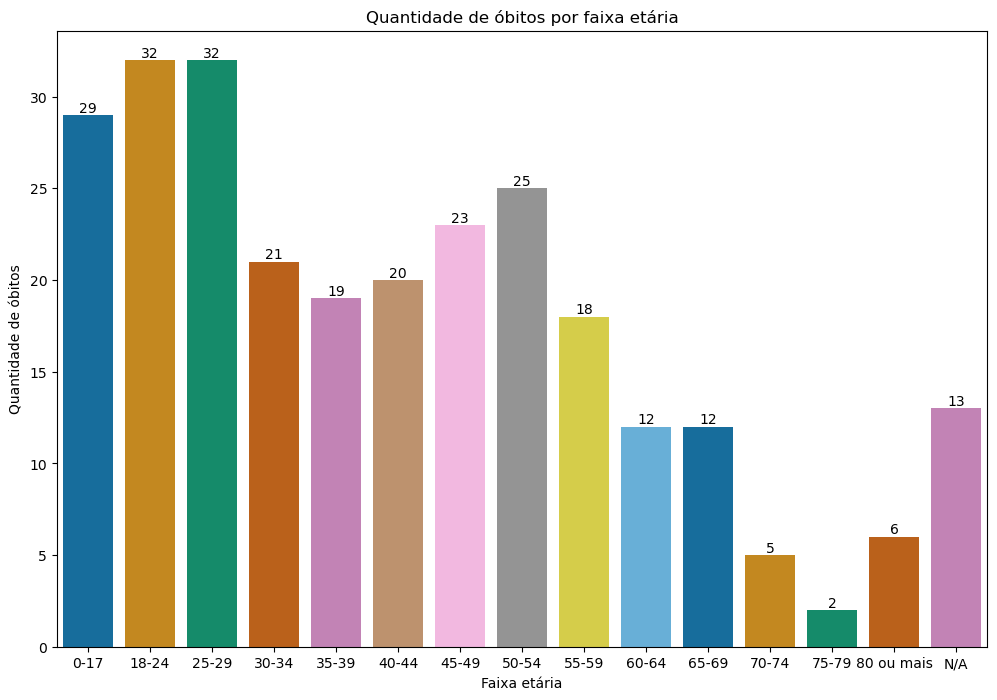

In [43]:
obitos_ciclista_sp_faixa_etaria = obitos_sp[(obitos_sp['Tipo do veículo da vítima'] == 'BICICLETA') & (obitos_sp['Município'] == 'SAO PAULO')]

obitos_ciclista_sp_faixa_etaria['Faixa etária'] = obitos_ciclista_sp_faixa_etaria['Faixa etária'].replace({'NAO DISPONIVEL': 'N/A'})

fig, ax = plt.subplots(figsize=(12, 8))
sns.countplot(x='Faixa etária', data=obitos_ciclista_sp_faixa_etaria.sort_values(by='Faixa etária'), palette='colorblind', ax= ax)

for bars in ax.containers:
    ax.bar_label(bars)

plt.title('Quantidade de óbitos por faixa etária')
plt.ylabel('Quantidade de óbitos')

plt.savefig('obitos_faixa_etaria.png', dpi=fig.dpi)


plt.show()

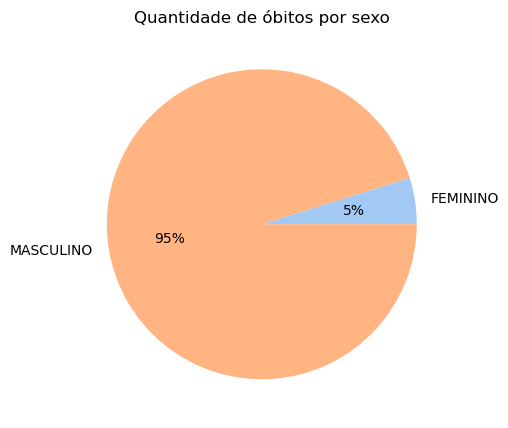

In [44]:
obitos_mulheres = obitos_ciclista_sp_faixa_etaria.groupby(by='Sexo',as_index=False).count()['Id da Delegacia (RDO)'][0]
obitos_homens = obitos_ciclista_sp_faixa_etaria.groupby(by='Sexo',as_index=False).count()['Id da Delegacia (RDO)'][1]

labels_mulheres = obitos_ciclista_sp_faixa_etaria.groupby(by='Sexo',as_index=False).count()['Sexo'][0]
labels_homens = obitos_ciclista_sp_faixa_etaria.groupby(by='Sexo',as_index=False).count()['Sexo'][1]

data = [obitos_mulheres,obitos_homens]
labels = [labels_mulheres,labels_homens]

colors = sns.color_palette('pastel')[0:5]

fig, ax = plt.subplots(figsize=(5, 7))

plt.pie(data, labels = labels, colors = colors, autopct='%.0f%%')

# sns.countplot(x='Sexo', data=obitos_ciclista_sp_faixa_etaria.sort_values(by='Faixa etária'), palette='colorblind',ax= ax)
# for bars in ax.containers:
#     ax.bar_label(bars)

plt.title('Quantidade de óbitos por sexo')

plt.savefig('obitos_sexo.png', dpi=fig.dpi)

plt.show()

In [45]:
def acidentes_por_veiculo(veiculo_envolvido, veiculo):
    df_acidente = nao_fatais_ciclistas.groupby(veiculo_envolvido, as_index=False)['ID'].count()
    df_acidente = df_acidente[df_acidente[veiculo_envolvido] == 1]
    df_acidente['Outro Veículo Envolvido'] = veiculo
    df_acidente = df_acidente.drop(veiculo_envolvido,axis=1)
    df_acidente = df_acidente.rename(columns={"ID": "Quantidade"})
    
    return df_acidente

acidentes_caminhao = acidentes_por_veiculo('Veículos Envolvidos - Caminhão', 'CAMINHAO')
acidentes_carro = acidentes_por_veiculo('Veículos Envolvidos - Automóvel', 'AUTOMOVEL')
acidentes_moto = acidentes_por_veiculo('Veículos Envolvidos - Motocicleta', 'MOTOCICLETA')
acidentes_onibus = acidentes_por_veiculo('Veículos Envolvidos - Ônibus', 'ONIBUS')
acidentes_bicicleta = acidentes_por_veiculo('Veículos Envolvidos - Bicicleta','BICICLETA')
acidentes_pedestre = acidentes_por_veiculo('Veículos Envolvidos - Pedestre','PEDESTRE')

veiculos_obitos = obitos_ciclista_sp.groupby('Outro Veículo Envolvido', as_index=False)['Id da Delegacia (RDO)'].count()
veiculos_obitos = veiculos_obitos.drop(labels=[1],axis=0)
veiculos_obitos = veiculos_obitos.rename(columns={"Id da Delegacia (RDO)": "Quantidade"})
veiculos_obitos['Outro Veículo Envolvido'] = veiculos_obitos['Outro Veículo Envolvido'].replace({'NAO DISPONIVEL': 'OUTROS'})

df_acidentes_por_veiculo = pd.concat([acidentes_caminhao,acidentes_carro,acidentes_moto,
                                       acidentes_onibus,acidentes_pedestre], axis=0)
df_acidentes_por_veiculo = pd.merge(df_acidentes_por_veiculo,veiculos_obitos,on=['Outro Veículo Envolvido'],how='right')
df_acidentes_por_veiculo = df_acidentes_por_veiculo.fillna(0)
df_acidentes_por_veiculo['Quantidade'] = df_acidentes_por_veiculo['Quantidade_x'] + df_acidentes_por_veiculo['Quantidade_y']
df_acidentes_por_veiculo = df_acidentes_por_veiculo.drop(['Quantidade_x','Quantidade_y'],axis=1)
df_acidentes_por_veiculo

,Outro Veículo Envolvido,Quantidade
0,AUTOMOVEL,4318.0
1,CAMINHAO,175.0
2,MOTOCICLETA,4532.0
3,OUTROS,14.0
4,NÃO HÁ,51.0
5,ONIBUS,418.0
6,PEDESTRE,288.0


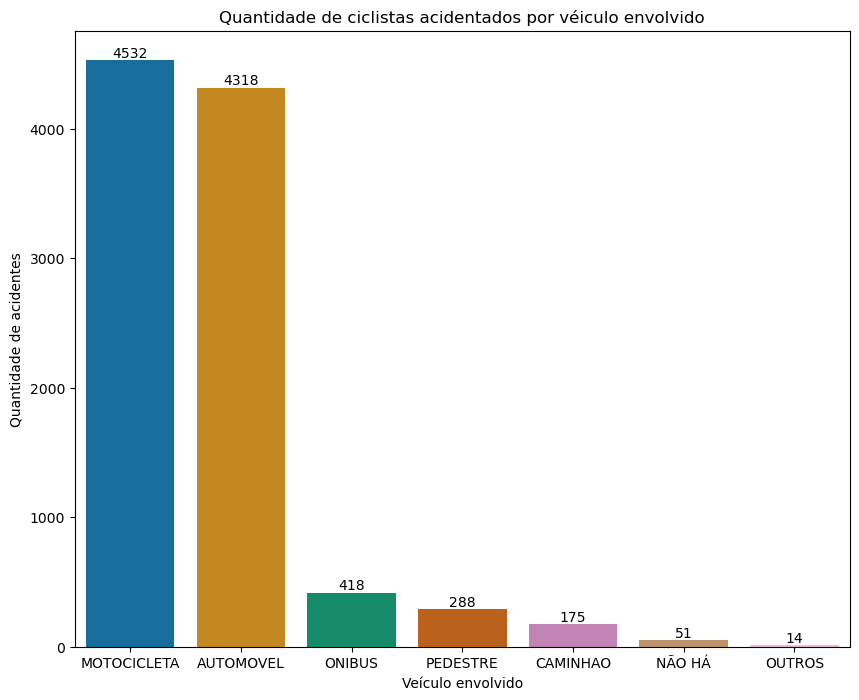

In [46]:
fig, ax = plt.subplots(figsize=(10, 8))
sns.barplot(x='Outro Veículo Envolvido', y= 'Quantidade',
            data=df_acidentes_por_veiculo.sort_values(by= 'Quantidade', ascending= False), palette='colorblind',ax= ax)

for bars in ax.containers:
    ax.bar_label(bars)

plt.title('Quantidade de ciclistas acidentados por véiculo envolvido')
plt.ylabel('Quantidade de acidentes')
plt.xlabel('Veículo envolvido')

plt.savefig('acidentes_veiculos_envolvidos.png', dpi=fig.dpi)

plt.show()

# Heatmap dos acidentes com ciclistas

In [47]:
heatmap_acidentes_ciclistas = acid_ciclistas[['Latitude','Longitude']]

mapa_de_calor_teste = folium.Map(location=[-23.5901,-46.6702],
                                 tiles = 'cartodbpositron',
                                  attr= 'Heatmap',
                                  zoom_start=15)

layer5 = cria_e_adiciona_features('Distritos',mapa_de_calor_teste,True)
layer6 = cria_e_adiciona_features('Ciclovia',mapa_de_calor_teste,True)
layer7 = cria_e_adiciona_features('Ciclorrota',mapa_de_calor_teste,True)
layer8 = cria_e_adiciona_features('Ciclofaixa',mapa_de_calor_teste,True)

adicionar_camadas(gdf_distrito,layer5,'distrito')
adicionar_camadas(gdf_ciclovia,layer6,'ciclovia')
adicionar_camadas(gdf_ciclorrota,layer7,'ciclorrota')
adicionar_camadas(gdf_ciclofaixa,layer8,'ciclofaixa')

HeatMap(data=heatmap_acidentes_ciclistas).add_to(mapa_de_calor_teste)

mapa_de_calor_teste

# Segurança Viária na Mobilidade Ativa

In [48]:
# 0.0306475 = 3411.664 metros ---> 1 metro = 0.00000898 = aprox. 0.000009

# 0.000018 = aprox. 2 metros
# 0.000045 = 5 metros
# 0.000063 = 7 metros
# 0.000090 = 10 metros
# 0.00018 = 20 metros

####   Ciclovia   ####
buffer_ciclovia = gdf_ciclovia[gdf_ciclovia['programa'] == 'CICLOVIA MONOTRILHO VILA PRUDENTE'][['programa','geometry']]

# Buffer para Acidentes Na Ciclovia
buffer_acidentes_na_ciclovia = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia.buffer(0.000045)))

# Buffer para Acidentes Fora da Ciclovia
buffer_acidentes_fora_da_ciclovia = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia.buffer(0.00018)))

# Junçao ciclovias bufferizadas com acidentes
acidentes_na_ciclovia = gpd.sjoin(left_df= buffer_acidentes_na_ciclovia, right_df=gdf_acidentes_ciclistas_localizados, how='inner')
acidentes_fora_da_ciclovia = gpd.sjoin(left_df= buffer_acidentes_fora_da_ciclovia, right_df=gdf_acidentes_ciclistas_localizados, how='inner')

####   Ciclofaixa   ####
buffer_ciclofaixa = gdf_ciclofaixa[gdf_ciclofaixa['programa'] == 'CICLOFAIXA LIBERDADE / VERGUEIRO'][['programa','geometry']]

# Buffer para Acidentes Na Ciclofaixa
buffer_acidentes_na_ciclofaixa = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclofaixa.buffer(0.000045)))

# Buffer para Acidentes Fora da Ciclofaixa
buffer_acidentes_fora_da_ciclofaixa = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclofaixa.buffer(0.00018)))

# Junçao ciclofaixas bufferizadas com acidentes
acidentes_na_ciclofaixa = gpd.sjoin(left_df= buffer_acidentes_na_ciclofaixa, right_df=gdf_acidentes_ciclistas_localizados, how='inner')
acidentes_fora_da_ciclofaixa = gpd.sjoin(left_df= buffer_acidentes_fora_da_ciclofaixa, right_df=gdf_acidentes_ciclistas_localizados, how='inner')

####   Ciclorrota   ####
buffer_ciclorrota = gdf_ciclorrota[gdf_ciclorrota['programa'] == 'CICLORROTA VILA MARIANA'][['programa','geometry']]
                                                       
# Buffer para Acidentes Na Ciclorrota
buffer_acidentes_na_ciclorrota = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclorrota.buffer(0.000045)))

# Buffer para Acidentes Fora da Ciclorrota
buffer_acidentes_fora_da_ciclorrota = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclorrota.buffer(0.000090)))

# Junçao ciclorrota bufferizadas com acidentes
acidentes_na_ciclorrota = gpd.sjoin(left_df= buffer_acidentes_na_ciclorrota, right_df=gdf_acidentes_ciclistas_localizados, how='inner')
acidentes_fora_da_ciclorrota = gpd.sjoin(left_df= buffer_acidentes_fora_da_ciclorrota, right_df=gdf_acidentes_ciclistas_localizados, how='inner')


C:\Users\danil\AppData\Local\Temp\ipykernel_29052\3704598593.py:13: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_acidentes_na_ciclovia = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia.buffer(0.000045)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\3704598593.py:16: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_acidentes_fora_da_ciclovia = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia.buffer(0.00018)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\3704598593.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_acidentes_na_ciclo

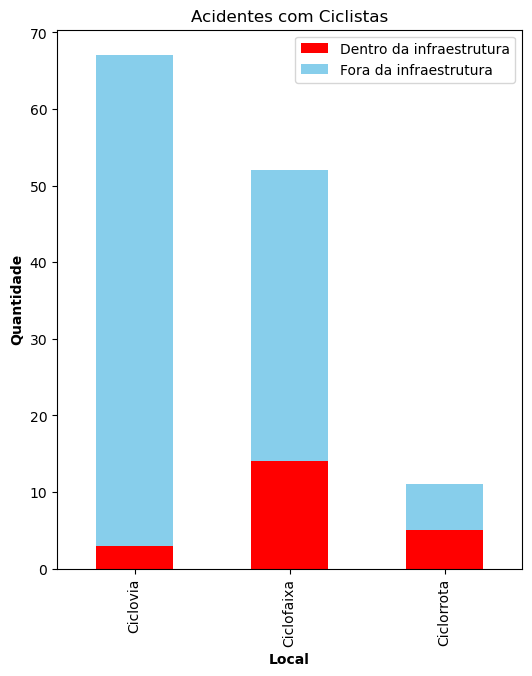

In [49]:
data = {'Dentro da infraestrutura': [len(acidentes_na_ciclovia), len(acidentes_na_ciclofaixa), len(acidentes_na_ciclorrota)],
        'Fora da infraestrutura': [len(acidentes_fora_da_ciclovia) - len(acidentes_na_ciclovia),
                            len(acidentes_fora_da_ciclofaixa) - len(acidentes_na_ciclofaixa),
                            len(acidentes_fora_da_ciclorrota) - len(acidentes_na_ciclorrota)]
        
       }
df_acidentes_dentro_e_fora_da_infra = pd.DataFrame(data,index=['Ciclovia','Ciclofaixa','Ciclorrota'])


fig, ax = plt.subplots(figsize=(6, 7))

# plot style
plt.style.use('seaborn-v0_8-dark-palette')

# create stacked bar chart for monthly temperatures
df_acidentes_dentro_e_fora_da_infra.plot(kind='bar', stacked=True, color=['red', 'skyblue'], ax = ax)

# labels for x & y axis
plt.xlabel('Local',fontweight='bold')
plt.ylabel('Quantidade', fontweight='bold')
 
# title of plot
plt.title('Acidentes com Ciclistas')
plt.savefig('exemplo_seguranca_viaria.png', bbox_inches='tight')

In [50]:
# 0.0306475 = 3411.664 metros ---> 1 metro = 0.00000898 = aprox. 0.000009

# 0.000018 = aprox. 2 metros
# 0.000045 = 5 metros
# 0.000063 = 7 metros
# 0.000090 = 10 metros
# 0.00018 = 20 metros

####   Ciclovia   ####
buffer_ciclovia_geral = gdf_ciclovia[['programa','geometry']]

# Buffer para Acidentes Na Ciclovia
buffer_acidentes_na_ciclovia_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia_geral.buffer(0.000045)))

# Buffer para Acidentes Fora da Ciclovia
buffer_acidentes_fora_da_ciclovia_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia_geral.buffer(0.00018)))

# Junçao ciclovias bufferizadas com acidentes
acidentes_na_ciclovia_geral = gpd.sjoin(left_df= buffer_acidentes_na_ciclovia_geral, right_df=gdf_acidentes_ciclistas_localizados, how='inner')
acidentes_fora_da_ciclovia_geral = gpd.sjoin(left_df= buffer_acidentes_fora_da_ciclovia_geral, right_df=gdf_acidentes_ciclistas_localizados, how='inner')

####   Ciclofaixa   ####
buffer_ciclofaixa_geral = gdf_ciclofaixa[['programa','geometry']]

# Buffer para Acidentes Na Ciclofaixa
buffer_acidentes_na_ciclofaixa_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclofaixa_geral.buffer(0.000045)))

# Buffer para Acidentes Fora da Ciclofaixa
buffer_acidentes_fora_da_ciclofaixa_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclofaixa_geral.buffer(0.00018)))

# Junçao ciclofaixas bufferizadas com acidentes
acidentes_na_ciclofaixa_geral = gpd.sjoin(left_df= buffer_acidentes_na_ciclofaixa_geral, right_df=gdf_acidentes_ciclistas_localizados, how='inner')
acidentes_fora_da_ciclofaixa_geral = gpd.sjoin(left_df= buffer_acidentes_fora_da_ciclofaixa_geral, right_df=gdf_acidentes_ciclistas_localizados, how='inner')

####   Ciclorrota   ####
buffer_ciclorrota_geral = gdf_ciclorrota[['programa','geometry']]
                                                       
# Buffer para Acidentes Na Ciclorrota
buffer_acidentes_na_ciclorrota_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclorrota_geral.buffer(0.000045)))

# Buffer para Acidentes Fora da Ciclorrota
buffer_acidentes_fora_da_ciclorrota_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclorrota_geral.buffer(0.000090)))

# Junçao ciclorrota bufferizadas com acidentes
acidentes_na_ciclorrota_geral = gpd.sjoin(left_df= buffer_acidentes_na_ciclorrota_geral, right_df=gdf_acidentes_ciclistas_localizados, how='inner')
acidentes_fora_da_ciclorrota_geral = gpd.sjoin(left_df= buffer_acidentes_fora_da_ciclorrota_geral, right_df=gdf_acidentes_ciclistas_localizados, how='inner')


C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1450573128.py:13: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_acidentes_na_ciclovia_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia_geral.buffer(0.000045)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1450573128.py:16: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_acidentes_fora_da_ciclovia_geral = gpd.GeoDataFrame(geometry=gpd.GeoSeries(buffer_ciclovia_geral.buffer(0.00018)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1450573128.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  b

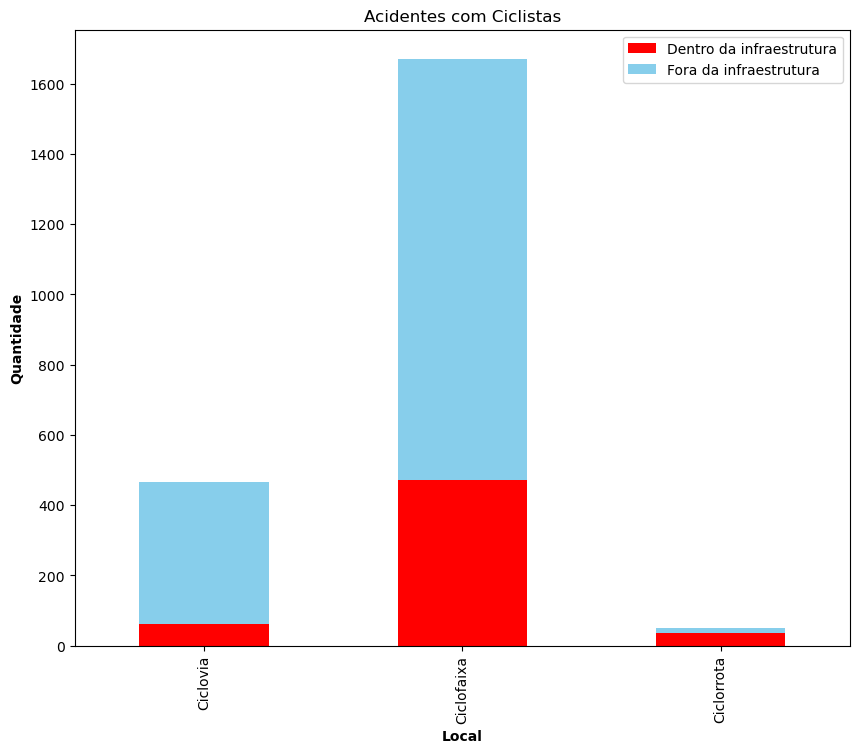

In [51]:
data_geral = {'Dentro da infraestrutura': [len(acidentes_na_ciclovia_geral), len(acidentes_na_ciclofaixa_geral), len(acidentes_na_ciclorrota_geral)],
        'Fora da infraestrutura': [len(acidentes_fora_da_ciclovia_geral) - len(acidentes_na_ciclovia_geral),
                            len(acidentes_fora_da_ciclofaixa_geral) - len(acidentes_na_ciclofaixa_geral),
                            len(acidentes_fora_da_ciclorrota_geral) - len(acidentes_na_ciclorrota_geral)]
        
       }
df_acidentes_dentro_e_fora_da_infra_geral = pd.DataFrame(data_geral,index=['Ciclovia','Ciclofaixa','Ciclorrota'])


fig, ax = plt.subplots(figsize=(10, 8))

# plot style
plt.style.use('seaborn-v0_8-dark-palette')

# create stacked bar chart for monthly temperatures
df_acidentes_dentro_e_fora_da_infra_geral.plot(kind='bar', stacked=True, color=['red', 'skyblue'], ax = ax)

# labels for x & y axis
plt.xlabel('Local',fontweight='bold')
plt.ylabel('Quantidade', fontweight='bold')
 
# title of plot
plt.title('Acidentes com Ciclistas')
plt.savefig('exemplo_seguranca_viaria_geral.png', bbox_inches='tight')

### Por km total de cada infraestrutura

In [52]:
km_total_ciclovia = sum(gdf_ciclovia.groupby(by=['programa','extensao_c'],as_index=False)['extensao_t'].sum()['extensao_c'])/1000
km_total_ciclofaixa = sum(gdf_ciclofaixa.groupby(by=['programa','extensao_c'],as_index=False)['extensao_t'].sum()['extensao_c'])/1000
km_total_ciclorrota = sum(gdf_ciclorrota.groupby(by=['programa','extensao_c'],as_index=False)['extensao_t'].sum()['extensao_c'])/1000

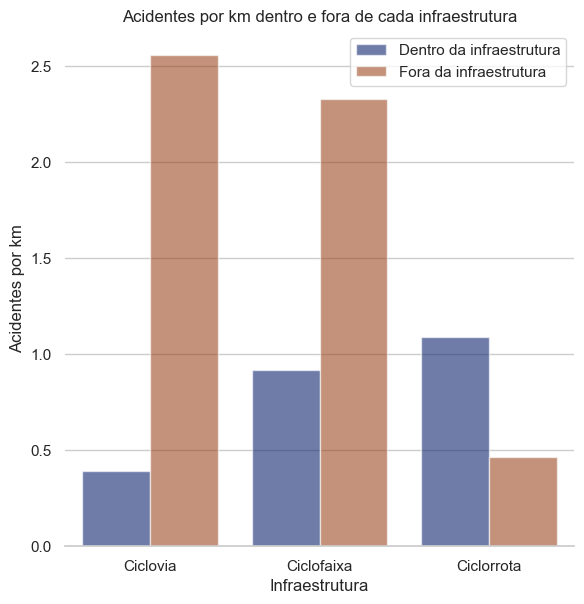

In [53]:
data_geral_km = {'Infraestrutura': ['Ciclovia','Ciclovia','Ciclofaixa','Ciclofaixa','Ciclorrota','Ciclorrota'],
                 'Qtd/km': [len(acidentes_na_ciclovia_geral)/km_total_ciclovia, (len(acidentes_fora_da_ciclovia_geral) - len(acidentes_na_ciclovia_geral))/km_total_ciclovia,
                                              len(acidentes_na_ciclofaixa_geral)/km_total_ciclofaixa, (len(acidentes_fora_da_ciclofaixa_geral) - len(acidentes_na_ciclofaixa_geral))/km_total_ciclofaixa,
                                              len(acidentes_na_ciclorrota_geral)/km_total_ciclorrota, (len(acidentes_fora_da_ciclorrota_geral) - len(acidentes_na_ciclorrota_geral))/km_total_ciclorrota],
                 'Local': ['Dentro da infraestrutura', 'Fora da infraestrutura',
                           'Dentro da infraestrutura', 'Fora da infraestrutura',
                           'Dentro da infraestrutura', 'Fora da infraestrutura']
        
       }
df_acidentes_dentro_e_fora_da_infra_geral_km = pd.DataFrame(data_geral_km)#,index=['Ciclovia','Ciclofaixa','Ciclorrota']

sns.set_theme(style="whitegrid")

# Draw a nested barplot by species and sex
g = sns.catplot(
    data=df_acidentes_dentro_e_fora_da_infra_geral_km, kind="bar",
    x="Infraestrutura", y="Qtd/km", hue="Local",
    errorbar="sd", palette="dark", alpha=.6, height=6, legend=False
)
g.despine(left=True)
plt.title("Acidentes por km dentro e fora de cada infraestrutura")
plt.legend(loc='upper right')
plt.savefig('exemplo_seguranca_viaria_geral_por_km.png', bbox_inches='tight')
g.set_axis_labels("Infraestrutura", "Acidentes por km")

In [54]:
####   Ciclovia   ####
ciclovia_original_1 = gdf_ciclovia.copy()
ciclovia_original_2 = gdf_ciclovia.copy()

buffer_ciclovia_indice_dentro = gpd.GeoDataFrame(data=ciclovia_original_1, geometry=gpd.GeoSeries(ciclovia_original_1.buffer(0.000045)))
buffer_ciclovia_indice_fora = gpd.GeoDataFrame(data= ciclovia_original_2, geometry=gpd.GeoSeries(ciclovia_original_2.buffer(0.00018)))

indice_acidentes_na_ciclovia = gpd.sjoin(left_df= buffer_ciclovia_indice_dentro, right_df=gdf_acidentes_ciclistas_localizados, how='left')
indice_acidentes_fora_da_ciclovia = gpd.sjoin(left_df= buffer_ciclovia_indice_fora, right_df=gdf_acidentes_ciclistas_localizados, how='left')

df_indice_na_ciclovia = indice_acidentes_na_ciclovia.groupby(by='geometry',as_index=False)['ID'].count()
df_indice_na_ciclovia.insert(0, 'New_ID', range(0, 0 + len(df_indice_na_ciclovia)))
df_indice_na_ciclovia = df_indice_na_ciclovia.rename(columns={"ID": "Qtd_dentro"})

df_indice_fora_ciclovia = indice_acidentes_fora_da_ciclovia.groupby(by='geometry',as_index=False)['ID'].count()
df_indice_fora_ciclovia.insert(0, 'New_ID', range(0, 0 + len(df_indice_fora_ciclovia)))
df_indice_fora_ciclovia = df_indice_fora_ciclovia.rename(columns={"ID": "Qtd_Fora"})

df_final_indice_ciclovias = pd.merge(df_indice_na_ciclovia,df_indice_fora_ciclovia, left_on='New_ID', right_on='New_ID')

df_final_indice_ciclovias['ind_prop_acid_perto_longe_infra_cicloviaria'] = (df_final_indice_ciclovias['Qtd_dentro'] /
                                                                            df_final_indice_ciclovias['Qtd_Fora'])
df_final_indice_ciclovias = df_final_indice_ciclovias.fillna(0)

df_final_indice_ciclovias = df_final_indice_ciclovias.drop('geometry_y',axis=1)
df_final_indice_ciclovias = df_final_indice_ciclovias.rename(columns={"geometry_x": "geometry"})

df_final_indice_ciclovias.ind_prop_acid_perto_longe_infra_cicloviaria = df_final_indice_ciclovias.ind_prop_acid_perto_longe_infra_cicloviaria.round(2)

gdf_indice_ciclovias = gpd.GeoDataFrame(df_final_indice_ciclovias,crs="EPSG:4326")

C:\Users\danil\AppData\Local\Temp\ipykernel_29052\2865673206.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_ciclovia_indice_dentro = gpd.GeoDataFrame(data=ciclovia_original_1, geometry=gpd.GeoSeries(ciclovia_original_1.buffer(0.000045)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\2865673206.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_ciclovia_indice_fora = gpd.GeoDataFrame(data= ciclovia_original_2, geometry=gpd.GeoSeries(ciclovia_original_2.buffer(0.00018)))


In [55]:
####   Ciclofaixa   ####
ciclofaixa_original_1 = gdf_ciclofaixa.copy()
ciclofaixa_original_2 = gdf_ciclofaixa.copy()

buffer_ciclofaixa_indice_dentro = gpd.GeoDataFrame(data=ciclofaixa_original_1, geometry=gpd.GeoSeries(ciclofaixa_original_1.buffer(0.000045)))
buffer_ciclofaixa_indice_fora = gpd.GeoDataFrame(data= ciclofaixa_original_2, geometry=gpd.GeoSeries(ciclofaixa_original_2.buffer(0.00018)))

indice_acidentes_na_ciclofaixa = gpd.sjoin(left_df= buffer_ciclofaixa_indice_dentro, right_df=gdf_acidentes_ciclistas_localizados, how='left')
indice_acidentes_fora_da_ciclofaixa = gpd.sjoin(left_df= buffer_ciclofaixa_indice_fora, right_df=gdf_acidentes_ciclistas_localizados, how='left')

df_indice_na_ciclofaixa = indice_acidentes_na_ciclofaixa.groupby(by='geometry',as_index=False)['ID'].count()
df_indice_na_ciclofaixa.insert(0, 'New_ID', range(0, 0 + len(df_indice_na_ciclofaixa)))
df_indice_na_ciclofaixa = df_indice_na_ciclofaixa.rename(columns={"ID": "Qtd_dentro"})

df_indice_fora_ciclofaixa = indice_acidentes_fora_da_ciclofaixa.groupby(by='geometry',as_index=False)['ID'].count()
df_indice_fora_ciclofaixa.insert(0, 'New_ID', range(0, 0 + len(df_indice_fora_ciclofaixa)))
df_indice_fora_ciclofaixa = df_indice_fora_ciclofaixa.rename(columns={"ID": "Qtd_Fora"})

df_final_indice_ciclofaixas = pd.merge(df_indice_na_ciclofaixa,df_indice_fora_ciclofaixa, left_on='New_ID', right_on='New_ID')
df_final_indice_ciclofaixas['ind_prop_acid_perto_longe_infra_cicloviaria'] = (df_final_indice_ciclofaixas['Qtd_dentro'] / df_final_indice_ciclofaixas['Qtd_Fora'])
df_final_indice_ciclofaixas = df_final_indice_ciclofaixas.fillna(0)
df_final_indice_ciclofaixas = df_final_indice_ciclofaixas.drop('geometry_y',axis=1)
df_final_indice_ciclofaixas = df_final_indice_ciclofaixas.rename(columns={"geometry_x": "geometry"})

df_final_indice_ciclofaixas.ind_prop_acid_perto_longe_infra_cicloviaria = df_final_indice_ciclofaixas.ind_prop_acid_perto_longe_infra_cicloviaria.round(2)

gdf_indice_ciclofaixas = gpd.GeoDataFrame(df_final_indice_ciclofaixas,crs="EPSG:4326")

C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1770626646.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_ciclofaixa_indice_dentro = gpd.GeoDataFrame(data=ciclofaixa_original_1, geometry=gpd.GeoSeries(ciclofaixa_original_1.buffer(0.000045)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1770626646.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_ciclofaixa_indice_fora = gpd.GeoDataFrame(data= ciclofaixa_original_2, geometry=gpd.GeoSeries(ciclofaixa_original_2.buffer(0.00018)))


In [56]:
####   Ciclorrota   ####
ciclorrota_original_1 = gdf_ciclorrota.copy()
ciclorrota_original_2 = gdf_ciclorrota.copy()

buffer_ciclorrota_indice_dentro = gpd.GeoDataFrame(data=ciclorrota_original_1, geometry=gpd.GeoSeries(ciclorrota_original_1.buffer(0.000045)))
buffer_ciclorrota_indice_fora = gpd.GeoDataFrame(data= ciclorrota_original_2, geometry=gpd.GeoSeries(ciclorrota_original_2.buffer(0.000090)))

indice_acidentes_na_ciclorrota = gpd.sjoin(left_df= buffer_ciclorrota_indice_dentro, right_df=gdf_acidentes_ciclistas_localizados, how='left')
indice_acidentes_fora_da_ciclorrota = gpd.sjoin(left_df= buffer_ciclorrota_indice_fora, right_df=gdf_acidentes_ciclistas_localizados, how='left')

df_indice_na_ciclorrota = indice_acidentes_na_ciclorrota.groupby(by='geometry',as_index=False)['ID'].count()
df_indice_na_ciclorrota.insert(0, 'New_ID', range(0, 0 + len(df_indice_na_ciclorrota)))
df_indice_na_ciclorrota = df_indice_na_ciclorrota.rename(columns={"ID": "Qtd_dentro"})

df_indice_fora_ciclorrota = indice_acidentes_fora_da_ciclorrota.groupby(by='geometry',as_index=False)['ID'].count()
df_indice_fora_ciclorrota.insert(0, 'New_ID', range(0, 0 + len(df_indice_fora_ciclorrota)))
df_indice_fora_ciclorrota = df_indice_fora_ciclorrota.rename(columns={"ID": "Qtd_Fora"})

df_final_indice_ciclorrotas = pd.merge(df_indice_na_ciclorrota,df_indice_fora_ciclorrota, left_on='New_ID', right_on='New_ID')
df_final_indice_ciclorrotas['ind_prop_acid_perto_longe_infra_cicloviaria'] = (df_final_indice_ciclorrotas['Qtd_dentro'] / df_final_indice_ciclorrotas['Qtd_Fora'])
df_final_indice_ciclorrotas = df_final_indice_ciclorrotas.fillna(0)
df_final_indice_ciclorrotas = df_final_indice_ciclorrotas.drop('geometry_y',axis=1)
df_final_indice_ciclorrotas = df_final_indice_ciclorrotas.rename(columns={"geometry_x": "geometry"})

df_final_indice_ciclorrotas.ind_prop_acid_perto_longe_infra_cicloviaria = df_final_indice_ciclorrotas.ind_prop_acid_perto_longe_infra_cicloviaria.round(2)

gdf_indice_ciclorrotas = gpd.GeoDataFrame(df_final_indice_ciclorrotas,crs="EPSG:4326")

C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1788917555.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_ciclorrota_indice_dentro = gpd.GeoDataFrame(data=ciclorrota_original_1, geometry=gpd.GeoSeries(ciclorrota_original_1.buffer(0.000045)))
C:\Users\danil\AppData\Local\Temp\ipykernel_29052\1788917555.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  buffer_ciclorrota_indice_fora = gpd.GeoDataFrame(data= ciclorrota_original_2, geometry=gpd.GeoSeries(ciclorrota_original_2.buffer(0.000090)))


In [57]:
import branca.colormap as cm

def my_linearColormap(GeoDataFrame,column):
    return cm.LinearColormap(['peachpuff','red'],
                           vmin=min(GeoDataFrame[column]),
                           vmax=max(GeoDataFrame[column]))

def create_color_column(GeoDataFrame, column, my_linearColormap):
    for x in GeoDataFrame.index:
        color = my_linearColormap(GeoDataFrame[column][x])
        GeoDataFrame.at[x, 'color'] = color
    
    return GeoDataFrame

def style(feature):
        return {
            'fillColor': feature['properties']['color'],
            'color': feature['properties']['color'],
            'weight': 2
        }
    
linear_ciclovia = my_linearColormap(gdf_indice_ciclovias,'ind_prop_acid_perto_longe_infra_cicloviaria')
linear_ciclofaixa = my_linearColormap(gdf_indice_ciclofaixas,'ind_prop_acid_perto_longe_infra_cicloviaria')
linear_ciclorrota = my_linearColormap(gdf_indice_ciclorrotas,'ind_prop_acid_perto_longe_infra_cicloviaria')

gdf_indice_ciclovias = create_color_column(gdf_indice_ciclovias,'ind_prop_acid_perto_longe_infra_cicloviaria',linear_ciclovia)
gdf_indice_ciclofaixas = create_color_column(gdf_indice_ciclofaixas,'ind_prop_acid_perto_longe_infra_cicloviaria',linear_ciclofaixa)
gdf_indice_ciclorrotas = create_color_column(gdf_indice_ciclorrotas,'ind_prop_acid_perto_longe_infra_cicloviaria',linear_ciclorrota)

# for x in gdf_indice.index:
#     color = linear(gdf_indice['ind_prop_acid_perto_longe_infra_cicloviaria'][x])
#     gdf_indice.at[x, 'color'] = color
mapa_indice = folium.Map(location=[-23.5901,-46.6702], tiles='cartodbpositron', zoom_start=13)

layer_indice_ciclovia = cria_e_adiciona_features('Índice Ciclovias',mapa_indice,True)
layer_indice_ciclofaixa = cria_e_adiciona_features('Índice Ciclofaixas',mapa_indice,True)
layer_indice_ciclorrota = cria_e_adiciona_features('Índice Ciclorrotas',mapa_indice,True)

# tiles='cartodbpositron',

folium.GeoJson(gdf_indice_ciclovias, style_function=style, tooltip=folium.features.GeoJsonTooltip(
                                                                    fields=['ind_prop_acid_perto_longe_infra_cicloviaria',],
                                                                    aliases=["Índice de Proporçao de Acidentes Perto e Longe da Infraestrutura: ",]
                                                            )
              ).add_to(layer_indice_ciclovia)

folium.GeoJson(gdf_indice_ciclofaixas, style_function=style, tooltip=folium.features.GeoJsonTooltip(
                                                                fields=['ind_prop_acid_perto_longe_infra_cicloviaria',],
                                                                aliases=["Índice de Proporçao de Acidentes Perto e Longe da Infraestrutura: ",]
                                                             )
              ).add_to(layer_indice_ciclofaixa)

folium.GeoJson(gdf_indice_ciclorrotas, style_function=style, tooltip=folium.features.GeoJsonTooltip(
                                                                fields=['ind_prop_acid_perto_longe_infra_cicloviaria',],
                                                                aliases=["Índice de Proporçao de Acidentes Perto e Longe da Infraestrutura: ",]
                                                             )
              ).add_to(layer_indice_ciclorrota)

folium.LayerControl(collapsed=False).add_to(mapa_indice)
mapa_indice